In [6]:
import pandas as pd
import numpy as np
import datetime as dt
from matplotlib.path import Path
import folium
from folium.plugins import MarkerCluster
import matplotlib.pyplot as plt
import seaborn as sns

In [7]:
initial_data = pd.read_csv("202501-bluebikes-tripdata.csv")

In [8]:
initial_data.head()

,ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual
0,215E35C14D594F94,classic_bike,2025-01-03 20:24:01.599,2025-01-03 20:28:53.443,Cambridge St at Joy St,D32000,Cross St at Hanover St,D32010,42.361257,-71.065287,42.362811,-71.056067,member
1,FFCD2D3BA2776BEE,electric_bike,2025-01-04 18:35:13.116,2025-01-04 18:41:07.672,Cambridge St at Joy St,D32000,Cross St at Hanover St,D32010,42.361257,-71.065287,42.362811,-71.056067,member
2,48EE2AAAB3450EED,classic_bike,2025-01-16 07:03:47.639,2025-01-16 07:30:52.520,Alewife MBTA at Steel Place,M32046,One Kendall Square at Hampshire St / Portland St,M32002,42.395588,-71.142606,42.366277,-71.091690,member
3,CEBF456BE80209BF,electric_bike,2025-01-13 08:38:00.822,2025-01-13 08:46:08.454,Deerfield St at Commonwealth Ave,B32037,Mass Ave at Albany St,M32061,42.349290,-71.097385,42.361358,-71.096703,member
4,F42C7FC3627D16D3,classic_bike,2025-01-14 20:23:16.339,2025-01-14 20:27:40.390,Broadway T Stop,C32053,Chinatown Gate Plaza,D32015,42.343049,-71.058034,42.351356,-71.059367,member


In [9]:
initial_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 162316 entries, 0 to 162315
Data columns (total 13 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   ride_id             162316 non-null  object 
 1   rideable_type       162316 non-null  object 
 2   started_at          162316 non-null  object 
 3   ended_at            162316 non-null  object 
 4   start_station_name  162254 non-null  object 
 5   start_station_id    162254 non-null  object 
 6   end_station_name    162038 non-null  object 
 7   end_station_id      161963 non-null  object 
 8   start_lat           162316 non-null  float64
 9   start_lng           162316 non-null  float64
 10  end_lat             162233 non-null  float64
 11  end_lng             162233 non-null  float64
 12  member_casual       162316 non-null  object 
dtypes: float64(4), object(9)
memory usage: 16.1+ MB


In [10]:
# drop irrelevant columns for now
initial_data.drop(['ride_id', 'start_station_id', 'end_station_id'], axis=1, inplace=True)

In [11]:
# rename columns
initial_data = initial_data.rename(columns={'rideable_type': 'bike_type', 
                                            'started_at': 'start_time', 
                                           'ended_at': 'end_time', 
                                           'start_station_name': 'start_station', 
                                           'end_station_name': 'end_station', 
                                           'member_casual': 'member_type'})

In [12]:
# switch times to datetimes without milliseconds
initial_data['start_time'] = pd.to_datetime(initial_data['start_time']).dt.floor('s')
initial_data['end_time'] = pd.to_datetime(initial_data['end_time']).dt.floor('s')

# cast some columns to strings
initial_data['member_type'] = initial_data['member_type'].astype('string')
initial_data['bike_type'] = initial_data['bike_type'].astype('string')
initial_data['start_station'] = initial_data['start_station'].astype('string')
initial_data['end_station'] = initial_data['end_station'].astype('string')

# rename bike types
initial_data['bike_type'] = initial_data['bike_type'].replace({'electric_bike': 'electric', 'classic_bike': 'classic'})


In [13]:
# calculate trip duration in min
initial_data['trip_duration'] = (initial_data['end_time'] - initial_data['start_time']).dt.total_seconds() / 60

# filter trips with duration between 2 min and 1 hour
initial_data_filtered = (initial_data[(initial_data['trip_duration'] > 2) & (initial_data['trip_duration'] < 60)]).copy()
initial_data_filtered['trip_duration'] = initial_data_filtered['trip_duration'].round(2) 

# function to convert time easily
def convert_to_minutes_seconds(time_value):
    minutes = int(time_value)
    seconds = round((time_value - minutes) * 60)
    return f"{minutes}m {seconds}s"

# make readable column of trip duration
initial_data_filtered['readable_duration'] = initial_data_filtered['trip_duration'].apply(convert_to_minutes_seconds)

# move columns
trip_duration = initial_data_filtered.pop('trip_duration')
initial_data_filtered.insert(3, 'trip_duration', trip_duration)

readable_duration = initial_data_filtered.pop('readable_duration')
initial_data_filtered.insert(4, 'readable_duration', readable_duration)

# see dataframe
initial_data_filtered.head()

,bike_type,start_time,end_time,trip_duration,readable_duration,start_station,end_station,start_lat,start_lng,end_lat,end_lng,member_type
0,classic,2025-01-03 20:24:01,2025-01-03 20:28:53,4.87,4m 52s,Cambridge St at Joy St,Cross St at Hanover St,42.361257,-71.065287,42.362811,-71.056067,member
1,electric,2025-01-04 18:35:13,2025-01-04 18:41:07,5.90,5m 54s,Cambridge St at Joy St,Cross St at Hanover St,42.361257,-71.065287,42.362811,-71.056067,member
2,classic,2025-01-16 07:03:47,2025-01-16 07:30:52,27.08,27m 5s,Alewife MBTA at Steel Place,One Kendall Square at Hampshire St / Portland St,42.395588,-71.142606,42.366277,-71.091690,member
3,electric,2025-01-13 08:38:00,2025-01-13 08:46:08,8.13,8m 8s,Deerfield St at Commonwealth Ave,Mass Ave at Albany St,42.349290,-71.097385,42.361358,-71.096703,member
4,classic,2025-01-14 20:23:16,2025-01-14 20:27:40,4.40,4m 24s,Broadway T Stop,Chinatown Gate Plaza,42.343049,-71.058034,42.351356,-71.059367,member


### Longitude and Latitude & Stations
To find filter through the stations we wanted we used [this website](https://www.mapdevelopers.com/area_finder.php?polygons=%5B%5B%5B%5B42.36759010833834%2C-71.07237106068662%5D%5D%2C%22%23AAAAAA%22%2C%22%23000000%22%2C0.4%5D%2C%5B%5B%5B42.367374486328195%2C-71.06538442759077%5D%2C%5B42.36965738757487%2C-71.05628637461226%5D%2C%5B42.36965738757487%2C-71.05182317881147%5D%2C%5B42.36813546262892%2C-71.04959158091108%5D%2C%5B42.36597933916783%2C-71.04873327402632%5D%2C%5B42.3640768158342%2C-71.04873327402632%5D%2C%5B42.36166687023572%2C-71.04821828989546%5D%2C%5B42.359637370665425%2C-71.04838995127241%5D%2C%5B42.35595873561401%2C-71.04959158091108%5D%2C%5B42.35557817486955%2C-71.04409841684858%5D%2C%5B42.35113812923902%2C-71.03259710459272%5D%2C%5B42.348093345233636%2C-71.02452901987593%5D%2C%5B42.34555591256596%2C-71.02143911509077%5D%2C%5B42.342891498035215%2C-71.02161077646772%5D%2C%5B42.33299411261206%2C-71.02367071299116%5D%2C%5B42.328679380180894%2C-71.0308804908232%5D%2C%5B42.329060103771766%2C-71.03894857553999%5D%2C%5B42.32918701112332%2C-71.04547170786421%5D%2C%5B42.32982154404046%2C-71.0506215491728%5D%2C%5B42.327664106006345%2C-71.06057790903608%5D%2C%5B42.32690263962191%2C-71.0751691260771%5D%2C%5B42.32537967920138%2C-71.08701376108687%5D%2C%5B42.32474510147804%2C-71.1029782691435%5D%2C%5B42.32626807726063%2C-71.11636785654585%5D%2C%5B42.33007535541508%2C-71.12289098887007%5D%2C%5B42.33654719943053%2C-71.12683920053999%5D%2C%5B42.34466778693545%2C-71.13216070322554%5D%2C%5B42.34999635252065%2C-71.13542226938765%5D%2C%5B42.3538021942577%2C-71.13542226938765%5D%2C%5B42.35633929405397%2C-71.13439230112593%5D%2C%5B42.35659299840031%2C-71.1297574439482%5D%2C%5B42.356846701722375%2C-71.1242642798857%5D%2C%5B42.3560855886834%2C-71.1191144385771%5D%2C%5B42.353548478644825%2C-71.11276296762983%5D%2C%5B42.35227988521693%2C-71.10795644907515%5D%2C%5B42.35215302446585%2C-71.09834341196577%5D%2C%5B42.352977614771%2C-71.09182027964155%5D%2C%5B42.35469019083713%2C-71.08529714731733%5D%2C%5B42.357354105293844%2C-71.0777440467314%5D%2C%5B42.360017906828105%2C-71.07413915781538%5D%2C%5B42.36306211316486%2C-71.07431081919233%5D%2C%5B42.36521833674818%2C-71.07104925303022%5D%2C%5B42.367374486328195%2C-71.06538442759077%5D%5D%2C%22%23AAAAAA%22%2C%22%23000000%22%2C0.4%5D%5D) to find the longitudes and latitudes we needed to be within. 

In [14]:
import re

# Extracting latitude and longitude values from the URL
url = "https://www.mapdevelopers.com/area_finder.php?polygons=%5B%5B%5B%5B42.36759010833834%2C-71.07237106068662%5D%5D%2C%22%23AAAAAA%22%2C%22%23000000%22%2C0.4%5D%2C%5B%5B%5B42.367374486328195%2C-71.06538442759077%5D%2C%5B42.36965738757487%2C-71.05628637461226%5D%2C%5B42.36965738757487%2C-71.05182317881147%5D%2C%5B42.36813546262892%2C-71.04959158091108%5D%2C%5B42.36597933916783%2C-71.04873327402632%5D%2C%5B42.3640768158342%2C-71.04873327402632%5D%2C%5B42.36166687023572%2C-71.04821828989546%5D%2C%5B42.359637370665425%2C-71.04838995127241%5D%2C%5B42.35595873561401%2C-71.04959158091108%5D%2C%5B42.35557817486955%2C-71.04409841684858%5D%2C%5B42.35113812923902%2C-71.03259710459272%5D%2C%5B42.348093345233636%2C-71.02452901987593%5D%2C%5B42.34555591256596%2C-71.02143911509077%5D%2C%5B42.342891498035215%2C-71.02161077646772%5D%2C%5B42.33299411261206%2C-71.02367071299116%5D%2C%5B42.328679380180894%2C-71.0308804908232%5D%2C%5B42.329060103771766%2C-71.03894857553999%5D%2C%5B42.32918701112332%2C-71.04547170786421%5D%2C%5B42.32982154404046%2C-71.0506215491728%5D%2C%5B42.327664106006345%2C-71.06057790903608%5D%2C%5B42.32690263962191%2C-71.0751691260771%5D%2C%5B42.32537967920138%2C-71.08701376108687%5D%2C%5B42.32474510147804%2C-71.1029782691435%5D%2C%5B42.32626807726063%2C-71.11636785654585%5D%2C%5B42.33007535541508%2C-71.12289098887007%5D%2C%5B42.33654719943053%2C-71.12683920053999%5D%2C%5B42.34466778693545%2C-71.13216070322554%5D%2C%5B42.34999635252065%2C-71.13542226938765%5D%2C%5B42.3538021942577%2C-71.13542226938765%5D%2C%5B42.35633929405397%2C-71.13439230112593%5D%2C%5B42.35659299840031%2C-71.1297574439482%5D%2C%5B42.356846701722375%2C-71.1242642798857%5D%2C%5B42.3560855886834%2C-71.1191144385771%5D%2C%5B42.353548478644825%2C-71.11276296762983%5D%2C%5B42.35227988521693%2C-71.10795644907515%5D%2C%5B42.35215302446585%2C-71.09834341196577%5D%2C%5B42.352977614771%2C-71.09182027964155%5D%2C%5B42.35469019083713%2C-71.08529714731733%5D%2C%5B42.357354105293844%2C-71.0777440467314%5D%2C%5B42.360017906828105%2C-71.07413915781538%5D%2C%5B42.36306211316486%2C-71.07431081919233%5D%2C%5B42.36521833674818%2C-71.07104925303022%5D%2C%5B42.367374486328195%2C-71.06538442759077%5D%5D%2C%22%23AAAAAA%22%2C%22%23000000%22%2C0.4%5D%5D"

# Decode URL encoding and extract coordinates
decoded_url = url.replace("%2C", ",").replace("%5B", "[").replace("%5D", "]")

# Extract latitude and longitude pairs using regex
coords = re.findall(r"\[([\d\.\-]+),([\d\.\-]+)\]", decoded_url)

# Convert extracted strings to floats
lat_lng_list = [(float(lat), float(lng)) for lat, lng in coords]

# Display extracted latitudes and longitudes
# lat_lng_list


In [15]:
# Define the polygon for the specified area using extracted coordinates
polygon_coords = np.array([
    (42.36759010833834, -71.07237106068662),
    (42.367374486328195, -71.06538442759077),
    (42.36965738757487, -71.05628637461226),
    (42.36965738757487, -71.05182317881147),
    (42.36813546262892, -71.04959158091108),
    (42.36597933916783, -71.04873327402632),
    (42.3640768158342, -71.04873327402632),
    (42.36166687023572, -71.04821828989546),
    (42.359637370665425, -71.04838995127241),
    (42.35595873561401, -71.04959158091108),
    (42.35557817486955, -71.04409841684858),
    (42.35113812923902, -71.03259710459272),
    (42.348093345233636, -71.02452901987593),
    (42.34555591256596, -71.02143911509077),
    (42.342891498035215, -71.02161077646772),
    (42.33299411261206, -71.02367071299116),
    (42.328679380180894, -71.0308804908232),
    (42.329060103771766, -71.03894857553999),
    (42.32918701112332, -71.04547170786421),
    (42.32982154404046, -71.0506215491728),
    (42.327664106006345, -71.06057790903608),
    (42.32690263962191, -71.0751691260771),
    (42.32537967920138, -71.08701376108687),
    (42.32474510147804, -71.1029782691435),
    (42.32626807726063, -71.11636785654585),
    (42.33007535541508, -71.12289098887007),
    (42.33654719943053, -71.12683920053999),
    (42.34466778693545, -71.13216070322554),
    (42.34999635252065, -71.13542226938765),
    (42.3538021942577, -71.13542226938765),
    (42.35633929405397, -71.13439230112593),
    (42.35659299840031, -71.1297574439482),
    (42.356846701722375, -71.1242642798857),
    (42.3560855886834, -71.1191144385771),
    (42.353548478644825, -71.11276296762983),
    (42.35227988521693, -71.10795644907515),
    (42.35215302446585, -71.09834341196577),
    (42.352977614771, -71.09182027964155),
    (42.35469019083713, -71.08529714731733),
    (42.357354105293844, -71.0777440467314),
    (42.360017906828105, -71.07413915781538),
    (42.36306211316486, -71.07431081919233),
    (42.36521833674818, -71.07104925303022),
    (42.367374486328195, -71.06538442759077)])

# create a path object for the polygon
polygon_path = Path(polygon_coords)

# function to check if a point is within the polygon
def is_within_area(lat, lng):
    return polygon_path.contains_point((lat, lng))

# apply the filter to keep only trips where either start or end location is within the polygon
initial_data_filtered = initial_data_filtered[
    initial_data_filtered.apply(lambda row: is_within_area(row['start_lat'], row['start_lng']) or 
                         is_within_area(row['end_lat'], row['end_lng']), axis=1)]

initial_data_filtered.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 87588 entries, 0 to 162315
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   bike_type          87588 non-null  string        
 1   start_time         87588 non-null  datetime64[ns]
 2   end_time           87588 non-null  datetime64[ns]
 3   trip_duration      87588 non-null  float64       
 4   readable_duration  87588 non-null  object        
 5   start_station      87552 non-null  string        
 6   end_station        87491 non-null  string        
 7   start_lat          87588 non-null  float64       
 8   start_lng          87588 non-null  float64       
 9   end_lat            87588 non-null  float64       
 10  end_lng            87588 non-null  float64       
 11  member_type        87588 non-null  string        
dtypes: datetime64[ns](2), float64(5), object(1), string(4)
memory usage: 8.7+ MB


In [16]:
initial_data_filtered.head()

,bike_type,start_time,end_time,trip_duration,readable_duration,start_station,end_station,start_lat,start_lng,end_lat,end_lng,member_type
0,classic,2025-01-03 20:24:01,2025-01-03 20:28:53,4.87,4m 52s,Cambridge St at Joy St,Cross St at Hanover St,42.361257,-71.065287,42.362811,-71.056067,member
1,electric,2025-01-04 18:35:13,2025-01-04 18:41:07,5.90,5m 54s,Cambridge St at Joy St,Cross St at Hanover St,42.361257,-71.065287,42.362811,-71.056067,member
3,electric,2025-01-13 08:38:00,2025-01-13 08:46:08,8.13,8m 8s,Deerfield St at Commonwealth Ave,Mass Ave at Albany St,42.349290,-71.097385,42.361358,-71.096703,member
4,classic,2025-01-14 20:23:16,2025-01-14 20:27:40,4.40,4m 24s,Broadway T Stop,Chinatown Gate Plaza,42.343049,-71.058034,42.351356,-71.059367,member
10,electric,2025-01-10 08:16:59,2025-01-10 08:24:30,7.52,7m 31s,Broadway T Stop,Tremont St at W. Dedham St,42.343056,-71.057961,42.342549,-71.074214,member


In [17]:
# find num of unique stations 
stations = list(set(np.append(initial_data_filtered['start_station'].unique(), initial_data_filtered['end_station'].unique())))
print(f'Number of unique stations: {len(stations)}')

Number of unique stations: 419


In [18]:
# remove null rows
initial_data_filtered = initial_data_filtered.dropna()
initial_data_filtered.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 87470 entries, 0 to 162315
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   bike_type          87470 non-null  string        
 1   start_time         87470 non-null  datetime64[ns]
 2   end_time           87470 non-null  datetime64[ns]
 3   trip_duration      87470 non-null  float64       
 4   readable_duration  87470 non-null  object        
 5   start_station      87470 non-null  string        
 6   end_station        87470 non-null  string        
 7   start_lat          87470 non-null  float64       
 8   start_lng          87470 non-null  float64       
 9   end_lat            87470 non-null  float64       
 10  end_lng            87470 non-null  float64       
 11  member_type        87470 non-null  string        
dtypes: datetime64[ns](2), float64(5), object(1), string(4)
memory usage: 8.7+ MB


In [19]:
# randomly sample 5000 data
initial_data_filtered = initial_data_filtered.sample(n=5000, random_state = 44, ignore_index = True)
initial_data_filtered.head()

,bike_type,start_time,end_time,trip_duration,readable_duration,start_station,end_station,start_lat,start_lng,end_lat,end_lng,member_type
0,classic,2025-01-24 08:36:25,2025-01-24 08:57:29,21.07,21m 4s,Boylston St at Massachusetts Ave,Spaulding Rehabilitation Hospital - Charlestow...,42.347406,-71.086784,42.378338,-71.048927,member
1,classic,2025-01-17 18:50:08,2025-01-17 18:57:21,7.22,7m 13s,Ruggles T Stop - Columbus Ave at Melnea Cass Blvd,Washington St at Lenox St,42.336244,-71.087986,42.335099,-71.079038,member
2,classic,2025-01-14 18:01:40,2025-01-14 18:09:57,8.28,8m 17s,Boston City Hall - 28 State St,Nashua Street at Red Auerbach Way,42.358920,-71.057629,42.365673,-71.064263,member
3,classic,2025-01-30 12:09:03,2025-01-30 12:13:58,4.92,4m 55s,Government Center - Cambridge St at Court St,Charles Circle - Charles St at Cambridge St,42.359825,-71.059796,42.360793,-71.071190,member
4,electric,2025-01-13 08:23:43,2025-01-13 08:31:08,7.42,7m 25s,Harrison Ave at E. Dedham St,Boylston St at Berkeley St,42.339153,-71.069733,42.351142,-71.073292,member


In [20]:
map_center = [initial_data_filtered['start_lat'].mean(), initial_data_filtered['start_lng'].mean()]
m_cluster = folium.Map(location=map_center, zoom_start=13)
marker_cluster = MarkerCluster().add_to(m_cluster)
for idx, row in initial_data_filtered.iterrows():
    folium.Marker(
        location=[row['start_lat'], row['start_lng']],
        popup=f"Station: {row['start_station']}\nTrip Duration: {row['readable_duration']}"
    ).add_to(marker_cluster)
m_cluster


In [21]:
m_poly = folium.Map(location=map_center, zoom_start=13)

folium.Polygon(
    locations=[(lat, lng) for lat, lng in polygon_coords],
    color='green',
    weight=2,
    fill=False,
    popup='Defined Area'
).add_to(m_poly)

for idx, row in initial_data_filtered.iterrows():
    folium.CircleMarker(
        location=[row['start_lat'], row['start_lng']],
        radius=2,
        color='blue',
        fill=True,
        fill_opacity=0.5,
        popup=f"Start: {row['start_station']}"
    ).add_to(m_poly)
    folium.CircleMarker(
        location=[row['end_lat'], row['end_lng']],
        radius=2,
        color='red',
        fill=True,
        fill_opacity=0.5,
        popup=f"End: {row['end_station']}"
    ).add_to(m_poly)

m_poly


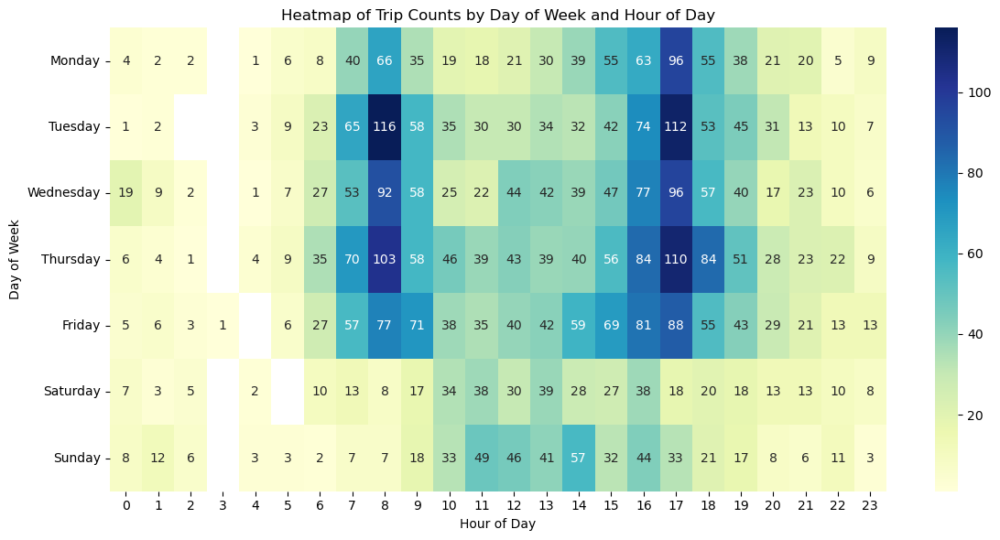

In [22]:

initial_data_filtered['day_of_week'] = initial_data_filtered['start_time'].dt.day_name()
initial_data_filtered['hour'] = initial_data_filtered['start_time'].dt.hour

pivot_trips = initial_data_filtered.pivot_table(index='day_of_week', columns='hour', values='trip_duration', aggfunc='count')
days_order = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]
pivot_trips = pivot_trips.reindex(days_order)

plt.figure(figsize=(12,6))
sns.heatmap(pivot_trips, cmap='YlGnBu', annot=True, fmt=".0f")
plt.title("Heatmap of Trip Counts by Day of Week and Hour of Day")
plt.xlabel("Hour of Day")
plt.ylabel("Day of Week")
plt.tight_layout()
plt.show()


In [23]:
def haversine(lat1, lon1, lat2, lon2):
    R = 6371.0  
    lat1, lon1, lat2, lon2 = map(np.radians, [lat1, lon1, lat2, lon2])
    dlat = lat2 - lat1 
    dlon = lon2 - lon1 
    a = np.sin(dlat/2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2
    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1-a))
    return R * c

initial_data_filtered['trip_distance_km'] = haversine(
    initial_data_filtered['start_lat'],
    initial_data_filtered['start_lng'],
    initial_data_filtered['end_lat'],
    initial_data_filtered['end_lng']
)


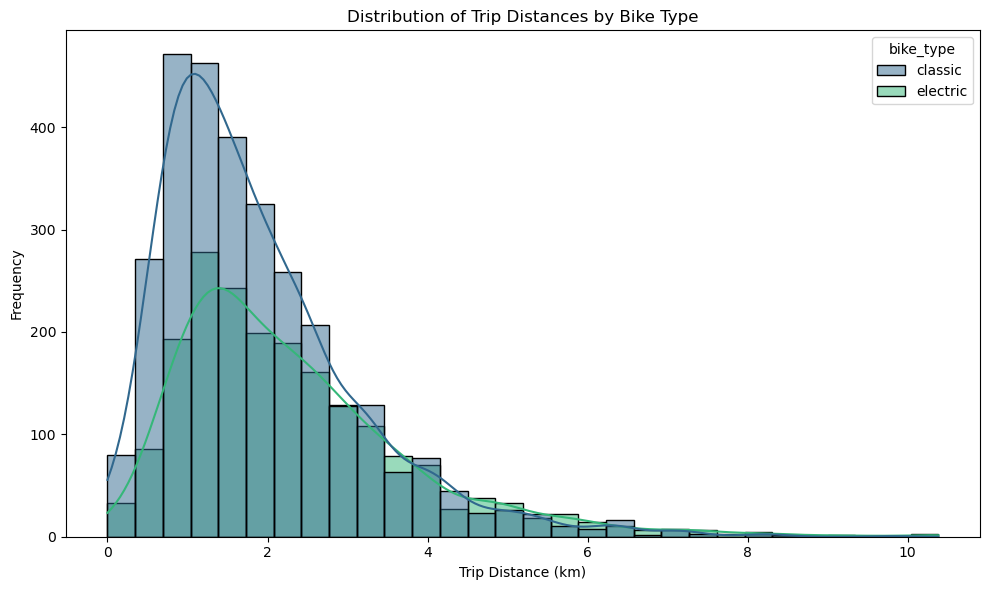

In [24]:
plt.figure(figsize=(10,6))
sns.histplot(
    data=initial_data_filtered, 
    x='trip_distance_km', 
    hue='bike_type', 
    bins=30, 
    kde=True, 
    palette='viridis'
)
plt.title("Distribution of Trip Distances by Bike Type")
plt.xlabel("Trip Distance (km)")
plt.ylabel("Frequency")
plt.tight_layout()
plt.show()


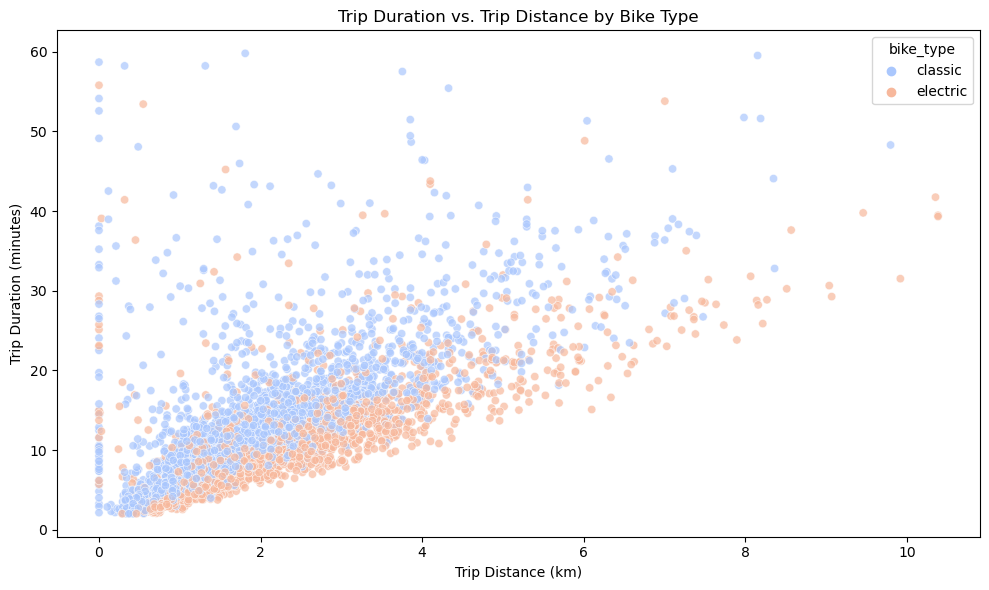

In [25]:
plt.figure(figsize=(10,6))
sns.scatterplot(
    data=initial_data_filtered, 
    x='trip_distance_km', 
    y='trip_duration', 
    hue='bike_type', 
    alpha=0.7, 
    palette='coolwarm'
)
plt.title("Trip Duration vs. Trip Distance by Bike Type")
plt.xlabel("Trip Distance (km)")
plt.ylabel("Trip Duration (minutes)")
plt.tight_layout()
plt.show()


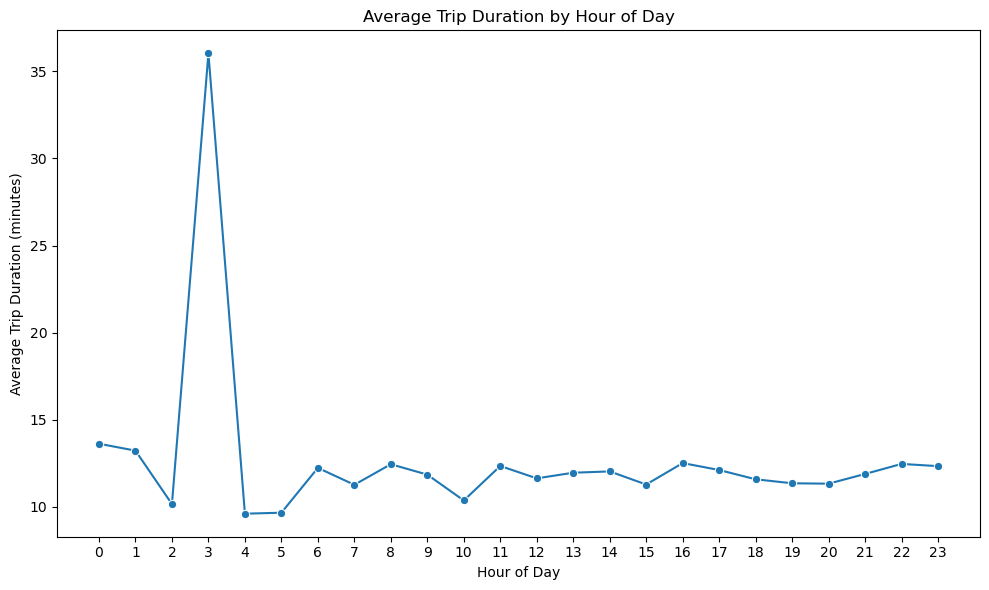

In [26]:
initial_data_filtered['hour'] = initial_data_filtered['start_time'].dt.hour
avg_duration_by_hour = initial_data_filtered.groupby('hour')['trip_duration'].mean().reset_index()

plt.figure(figsize=(10,6))
sns.lineplot(data=avg_duration_by_hour, x='hour', y='trip_duration', marker='o')
plt.title("Average Trip Duration by Hour of Day")
plt.xlabel("Hour of Day")
plt.ylabel("Average Trip Duration (minutes)")
plt.xticks(range(0, 24))
plt.tight_layout()
plt.show()
